In [1]:
import pandas as pd
import numpy as np
import json
import re 
import sys
import itertools

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt


import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from spotipy.oauth2 import SpotifyOAuth
import spotipy.util as util

import warnings
warnings.filterwarnings("ignore")

link location https://www.kaggle.com/yamaerenay/spotify-dataset-19212020-160k-tracks

In [2]:
%matplotlib inline

In [3]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

In [4]:
pd.set_option('display.max_columns', None)
pd.set_option("max_rows", None)

In [5]:
spotify_df = pd.read_csv('tracks.csv')

In [6]:
data_by_artist = pd.read_csv('data_by_artist_o.csv')
data_by_artist.head()

,genres,artists,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count
0,['show tunes'],"""Cats"" 1981 Original London Cast",0.590111,0.467222,250318.555556,0.394003,0.011400,0.290833,-14.448000,0.210389,117.518111,0.389500,38.333333,5,1,9
1,[],"""Cats"" 1983 Broadway Cast",0.862538,0.441731,287280.000000,0.406808,0.081158,0.315215,-10.690000,0.176212,103.044154,0.268865,30.576923,5,1,26
2,[],"""Fiddler On The Roof” Motion Picture Chorus",0.856571,0.348286,328920.000000,0.286571,0.024593,0.325786,-15.230714,0.118514,77.375857,0.354857,34.857143,0,1,7
3,[],"""Fiddler On The Roof” Motion Picture Orchestra",0.884926,0.425074,262890.962963,0.245770,0.073587,0.275481,-15.639370,0.123200,88.667630,0.372030,34.851852,0,1,27
4,[],"""Joseph And The Amazing Technicolor Dreamcoat""...",0.510714,0.467143,270436.142857,0.488286,0.009400,0.195000,-10.236714,0.098543,122.835857,0.482286,43.000000,5,1,7


In [7]:
data_by_artist['genres_upd'] = data_by_artist['genres'].apply(lambda x: [re.sub(' ','_',i) for i in re.findall(r"'([^']*)'", x)])
data_by_artist['genres_upd'].values[0][0]

'show_tunes'

In [8]:
spotify_df['artists_upd_v1'] = spotify_df['artists'].apply(lambda x: re.findall(r"'([^']*)'", x))

In [9]:
spotify_df[spotify_df['artists_upd_v1'].apply(lambda x: not x)].head(5)

,id,name,popularity,duration_ms,explicit,artists,id_artists,release_date,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,artists_upd_v1
164,1xEEYhWxT4WhDQdxfPCT8D,Snake Rag,20,194533,0,"[""King Oliver's Creole Jazz Band""]",['08Zk65toyJllap1MnzljxZ'],1923,0.708,0.361,0,-11.764,0,0.0441,0.994,0.883,0.103,0.902,105.695,4,[]
170,3rauXVLOOM5BlxWqUcDpkg,Chimes Blues,14,170827,0,"[""King Oliver's Creole Jazz Band""]",['08Zk65toyJllap1MnzljxZ'],1923,0.546,0.189,0,-15.984,1,0.0581,0.996,0.908,0.339,0.554,80.318,4,[]
172,1UdqHVRFYMZKU2Q7xkLtYc,Pickin' On Your Baby,11,197493,0,"[""Clarence Williams' Blue Five""]",['6RuQvIr0t0otZHnAxXTGkm'],1923,0.520,0.153,0,-14.042,1,0.0440,0.995,0.131,0.353,0.319,102.937,4,[]
174,0Vl2DO5U6FjgBpzCtBN3OA,Everybody Loves My Baby,10,152507,0,"[""Clarence Williams' Blue Five""]",['6RuQvIr0t0otZHnAxXTGkm'],1923,0.514,0.193,2,-13.920,0,0.2380,0.996,0.199,0.248,0.665,180.674,4,[]
180,5SvyP1ZeJX1jA7AOZD08NA,Tears,10,187227,0,"[""King Oliver's Creole Jazz Band""]",['08Zk65toyJllap1MnzljxZ'],1923,0.359,0.357,3,-11.810,1,0.0511,0.994,0.819,0.290,0.753,205.053,4,[]


In [10]:
spotify_df['artists_upd_v2'] = spotify_df['artists'].apply(lambda x: re.findall('\"(.*?)\"',x))
spotify_df['artists_upd'] = np.where(spotify_df['artists_upd_v1'].apply(lambda x: not x), spotify_df['artists_upd_v2'], spotify_df['artists'])

In [11]:
spotify_df['artists_song'] = spotify_df.apply(lambda row: str(row['artists_upd'][2:-2])+str(row['name']),axis = 1)

In [12]:
spotify_df.sort_values(['artists_song','release_date'], ascending = False, inplace = True)

In [13]:
spotify_df.drop_duplicates('artists_song',inplace = True)

In [14]:
artists_exploded = spotify_df[['artists_upd','id']].explode('artists_upd')

In [15]:
artists_exploded_enriched = artists_exploded.merge(data_by_artist, how = 'left', left_on = 'artists_upd',right_on = 'artists')
artists_exploded_enriched_nonnull = artists_exploded_enriched[~artists_exploded_enriched.genres_upd.isnull()]

In [16]:
artists_genres_consolidated = artists_exploded_enriched_nonnull.groupby('id')['genres_upd'].apply(list).reset_index()

In [17]:
artists_genres_consolidated['consolidates_genre_lists'] = artists_genres_consolidated['genres_upd'].apply(lambda x: list(set(list(itertools.chain.from_iterable(x)))))

In [18]:
spotify_df = spotify_df.merge(artists_genres_consolidated[['id','consolidates_genre_lists']], on = 'id',how = 'left')

In [19]:
spotify_df.head()

,id,name,popularity,duration_ms,explicit,artists,id_artists,release_date,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,artists_upd_v1,artists_upd_v2,artists_upd,artists_song,consolidates_genre_lists
0,3u1C6nWVRoP5F0w8gGrDL3,사랑의 미로,25,222380,0,['최진희'],['1NSrAf8XJYJVgAXKoxaMet'],1987-06-01,0.367,0.194,7,-19.057,1,0.0400,0.617,0.000006,0.1620,0.367,144.316,4,[최진희],[],['최진희'],최진희사랑의 미로,NaN
1,1Mv4u308L16NZDZiD6HZCy,사랑은 힘든가봐,28,213440,0,['지수'],['4c9QIMfEbIIynuaswyxGx9'],2005-12-23,0.675,0.785,4,-5.026,0,0.0280,0.379,0.000000,0.3530,0.623,103.008,4,[지수],[],['지수'],지수사랑은 힘든가봐,NaN
2,1jvoY322nxyKXq8OBhgmSY,어떡하죠,44,244360,0,['지선'],['2Mo9NQaNCFCWSR5CnlfmbN'],2011-10-13,0.606,0.341,0,-7.094,1,0.0513,0.779,0.000000,0.1440,0.294,135.667,4,[지선],[],['지선'],지선어떡하죠,NaN
3,2ghebdwe2pNXT4eL34T7pW,그아픔까지사랑한거야,32,237688,0,['조정현'],['2WTpsPucygbYRnCnoEUkJQ'],1989-06-15,0.447,0.215,10,-16.478,1,0.0272,0.568,0.000001,0.0649,0.177,71.979,4,[조정현],[],['조정현'],조정현그아픔까지사랑한거야,NaN
4,7rxpWwcXNgDUXl0wN0gUvp,천국의 기억 장정우 Version,31,280372,0,['장정우'],['5L7zKs2ftwENWOMI7LFaN1'],2003-12-24,0.494,0.656,7,-6.347,0,0.0262,0.659,0.000007,0.1110,0.420,82.003,4,[장정우],[],['장정우'],장정우천국의 기억 장정우 Version,NaN


In [20]:
spotify_df.tail()

,id,name,popularity,duration_ms,explicit,artists,id_artists,release_date,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,artists_upd_v1,artists_upd_v2,artists_upd,artists_song,consolidates_genre_lists
526570,5UbK7BJAIhkUIYYLUABLdN,The Last Supper,30,428507,0,"['""Jesus Christ Superstar"" Apostles - Original...","['1T1Hnf7jWiJPFUTi6voWwU', '479Yp6DvyXoIaCssAx...",1970-01-01,0.397,0.396,7,-8.094,1,0.0345,0.5930,0.000000,0.0997,0.232,121.013,4,"[""Jesus Christ Superstar"" Apostles - Original ...",[Jesus Christ Superstar],"['""Jesus Christ Superstar"" Apostles - Original...","""Jesus Christ Superstar"" Apostles - Original S...",NaN
526571,2itG1gLI0n9tH1DZKJbPd2,The Warrior,11,249493,0,"['""Ipi Ntombi"" 1975 Original Cast']",['2rV4kKW3Yvqh40hpDH1gpy'],1975-01-01,0.749,0.590,0,-5.699,1,0.0528,0.1580,0.003260,0.1440,0.574,116.904,4,"[""Ipi Ntombi"" 1975 Original Cast]",[Ipi Ntombi],"['""Ipi Ntombi"" 1975 Original Cast']","""Ipi Ntombi"" 1975 Original CastThe Warrior",NaN
526572,52V0laIHD3rvFZrwqDPHFe,Shosholoza,17,231733,0,"['""Ipi Ntombi"" 1975 Original Cast']",['2rV4kKW3Yvqh40hpDH1gpy'],1975-01-01,0.721,0.534,0,-10.546,1,0.0506,0.4960,0.000000,0.1110,0.923,114.075,4,"[""Ipi Ntombi"" 1975 Original Cast]",[Ipi Ntombi],"['""Ipi Ntombi"" 1975 Original Cast']","""Ipi Ntombi"" 1975 Original CastShosholoza",NaN
526573,5qhaazvxbhR8mBlo1LXTuY,Narration: Mama Tembu's Wedding,7,182733,0,"['""Ipi Ntombi"" 1975 Original Cast']",['2rV4kKW3Yvqh40hpDH1gpy'],1975-01-01,0.604,0.803,0,-6.785,1,0.4300,0.4260,0.000000,0.2480,0.916,134.034,4,"[""Ipi Ntombi"" 1975 Original Cast]",[Ipi Ntombi],"['""Ipi Ntombi"" 1975 Original Cast']","""Ipi Ntombi"" 1975 Original CastNarration: Mama...",NaN
526574,5zGtzufGU0xPwdrtellshR,Ipi Ntombi,16,217533,0,"['""Ipi Ntombi"" 1975 Original Cast']",['2rV4kKW3Yvqh40hpDH1gpy'],1975-01-01,0.694,0.802,9,-6.316,1,0.0574,0.0232,0.000006,0.1960,0.734,116.591,4,"[""Ipi Ntombi"" 1975 Original Cast]",[Ipi Ntombi],"['""Ipi Ntombi"" 1975 Original Cast']","""Ipi Ntombi"" 1975 Original CastIpi Ntombi",NaN


In [21]:
spotify_df['year'] = spotify_df['release_date'].apply(lambda x: x.split('-')[0])

In [22]:
float_cols = spotify_df.dtypes[spotify_df.dtypes == 'float64'].index.values

In [23]:
ohe_cols = 'popularity'

In [24]:
spotify_df['popularity'].describe()

count    526575.000000
mean         27.193697
std          18.048252
min           0.000000
25%          13.000000
50%          27.000000
75%          40.000000
max          99.000000
Name: popularity, dtype: float64

In [25]:
# create 5 point buckets for popularity 
spotify_df['popularity_red'] = spotify_df['popularity'].apply(lambda x: int(x/5))

In [26]:
# tfidf can't handle nulls so fill any null values with an empty list
spotify_df['consolidates_genre_lists'] = spotify_df['consolidates_genre_lists'].apply(lambda d: d if isinstance(d, list) else [])

In [27]:
"One Hot Encoder stuff"
def ohe_prep(df, column, new_name): 
    """ 
    Create One Hot Encoded features of a specific column

    Parameters: 
        df (pandas dataframe): Spotify Dataframe
        column (str): Column to be processed
        new_name (str): new column name to be used
        
    Returns: 
        tf_df: One hot encoded features 
    """
    
    tf_df = pd.get_dummies(df[column])
    feature_names = tf_df.columns
    tf_df.columns = [new_name + "|" + str(i) for i in feature_names]
    tf_df.reset_index(drop = True, inplace = True)    
    return tf_df

In [28]:
#function to build entire feature set
def create_feature_set(df, float_cols):
    """ 
    Process spotify df to create a final set of features that will be used to generate recommendations

    Parameters: 
        df (pandas dataframe): Spotify Dataframe
        float_cols (list(str)): List of float columns that will be scaled 
        
    Returns: 
        final: final set of features 
    """
    
    #tfidf genre lists
    tfidf = TfidfVectorizer()
    tfidf_matrix =  tfidf.fit_transform(df['consolidates_genre_lists'].apply(lambda x: " ".join(x)))
    genre_df = pd.DataFrame(tfidf_matrix.toarray())
    genre_df.columns = ['genre' + "|" + i for i in tfidf.get_feature_names()]
    genre_df.reset_index(drop = True, inplace=True)

    #explicity_ohe = ohe_prep(df, 'explicit','exp')    
    year_ohe = ohe_prep(df, 'year','year') * 0.5
    popularity_ohe = ohe_prep(df, 'popularity_red','pop') * 0.15

    #scale float columns
    floats = df[float_cols].reset_index(drop = True)
    scaler = MinMaxScaler()
    floats_scaled = pd.DataFrame(scaler.fit_transform(floats), columns = floats.columns) * 0.2

    #concanenate all features
    final = pd.concat([genre_df, floats_scaled, popularity_ohe, year_ohe], axis = 1)
     
    #add song id
    final['id']=df['id'].values
    
    return final

In [29]:
complete_feature_set = create_feature_set(spotify_df, float_cols=float_cols)

In [30]:
#complete_feature_set.head()

In [31]:
#complete_feature_set.shape

In [32]:
def generate_playlist_feature(complete_feature_set, playlist_df, weight_factor):
    """ 
    Summarize a user's playlist into a single vector

    Parameters: 
        complete_feature_set (pandas dataframe): Dataframe which includes all of the features for the spotify songs
        playlist_df (pandas dataframe): playlist dataframe
        weight_factor (float): float value that represents the recency bias. The larger the recency bias, the most priority recent songs get. Value should be close to 1. 
        
    Returns: 
        playlist_feature_set_weighted_final (pandas series): single feature that summarizes the playlist
        complete_feature_set_nonplaylist (pandas dataframe): 
    """
    
    complete_feature_set_playlist = complete_feature_set[complete_feature_set['id'].isin(playlist_df['id'].values)]#.drop('id', axis = 1).mean(axis =0)
    complete_feature_set_playlist = complete_feature_set_playlist.merge(playlist_df[['id','date_added']], on = 'id', how = 'inner')
    complete_feature_set_nonplaylist = complete_feature_set[~complete_feature_set['id'].isin(playlist_df['id'].values)]#.drop('id', axis = 1)
    
    playlist_feature_set = complete_feature_set_playlist.sort_values('date_added',ascending=False)

    most_recent_date = playlist_feature_set.iloc[0,-1]
    
    for ix, row in playlist_feature_set.iterrows():
        playlist_feature_set.loc[ix,'months_from_recent'] = int((most_recent_date.to_pydatetime() - row.iloc[-1].to_pydatetime()).days / 30)
        
    playlist_feature_set['weight'] = playlist_feature_set['months_from_recent'].apply(lambda x: weight_factor ** (-x))
    
    playlist_feature_set_weighted = playlist_feature_set.copy()
    #print(playlist_feature_set_weighted.iloc[:,:-4].columns)
    playlist_feature_set_weighted.update(playlist_feature_set_weighted.iloc[:,:-4].mul(playlist_feature_set_weighted.weight,0))
    playlist_feature_set_weighted_final = playlist_feature_set_weighted.iloc[:, :-4]
    #playlist_feature_set_weighted_final['id'] = playlist_feature_set['id']
    
    return playlist_feature_set_weighted_final.sum(axis = 0), complete_feature_set_nonplaylist

In [33]:
#complete_feature_set_playlist_vector, complete_feature_set_nonplaylist = generate_playlist_feature(complete_feature_set, playlist_checks, 1.09)

In [34]:
#spotify_df.head()

In [35]:
spotify_df = spotify_df.merge(complete_feature_set, on = 'id',how = 'left')

In [36]:
#spotify_df.head()

In [37]:
spotify_df.shape

(526575, 465)

In [38]:
#spotify_df.dtypes

In [39]:
mylist = list(spotify_df.select_dtypes(include=['object']).columns)
mylist

['id',
 'name',
 'artists',
 'id_artists',
 'release_date',
 'artists_upd_v1',
 'artists_upd_v2',
 'artists_upd',
 'artists_song',
 'consolidates_genre_lists',
 'year']

In [40]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import numpy as np

X_prep = spotify_df.drop(['id', 'name',
 'artists',
 'id_artists',
 'release_date',
 'artists_upd_v1',
 'artists_upd_v2',
 'artists_upd',
 'artists_song',
 'consolidates_genre_lists',
 'year'], axis = 1).sample(frac = 0.3)
# Transform the data into 2D so we can see
pca = PCA(2) 
X_2D = pca.fit_transform(X_prep)
X_2D

array([[-2.20452854e+04, -5.20823459e+01],
       [ 5.42171463e+03,  3.15582492e+01],
       [ 1.07448715e+05,  3.94338102e+01],
       ...,
       [-1.38871285e+05,  4.46180613e+00],
       [-1.29112853e+04, -4.43856269e+00],
       [-9.60452854e+04, -5.27512401e+01]])

In [41]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=13, random_state=42)
kmeans.fit(X_2D)

KMeans(n_clusters=13, random_state=42)

In [42]:
clusters = kmeans.predict(X_2D)
clusters

array([ 0,  7,  8, ...,  5,  7, 10])

In [43]:
X_prep.index

Int64Index([265199, 343254, 269601, 153491, 397528, 175528, 416201, 194539,
            370770, 447421,
            ...
            372757, 497703,  91183, 401013, 332553, 169065, 424467, 426341,
            281706,  39889],
           dtype='int64', length=157972)

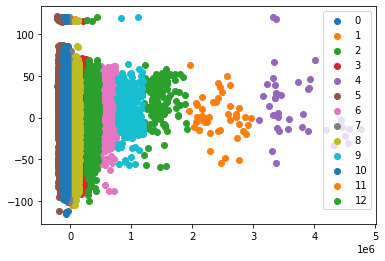

In [44]:
labels = np.unique(clusters)

for i in labels:
    plt.scatter(X_2D[clusters == i , 0] , X_2D[clusters == i , 1] , label = i)
plt.legend()
plt.show()

In [45]:
df = pd.DataFrame(X_2D)
df['cluster'] = clusters
df

,0,1,cluster
0,-2.204529e+04,-52.082346,0
1,5.421715e+03,31.558249,7
2,1.074487e+05,39.433810,8
3,6.314715e+03,7.389720,7
4,-7.261829e+04,0.851614,10
5,-1.179803e+05,13.570879,5
6,-1.564313e+05,5.289533,5
7,-1.007129e+04,9.980097,7
8,-3.964229e+04,-66.244803,0
9,-3.465829e+04,21.306261,0


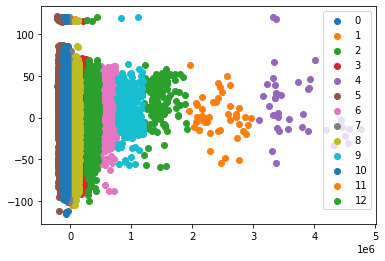

In [46]:
for i in labels:
    plt.scatter(df[df['cluster'] == i][0] , df[df['cluster'] == i][1] , label = i)
plt.legend()
plt.show()

In [47]:
#from sklearn.metrics import classification_report
#print(classification_report(clusters))

In [48]:
# Getting nearest point
from sklearn.metrics import pairwise_distances_argmin_min

X = df.drop('cluster', axis=1)
closest, _ = pairwise_distances_argmin_min(X.loc[[1]], X)
# here, this X.loc[[0]] would be representing "a new song"
closest

array([1], dtype=int64)

In [49]:
X.loc[1]

0    5421.714628
1      31.558249
Name: 1, dtype: float64

In [50]:
X.head

<bound method NDFrame.head of                    0           1
0      -2.204529e+04  -52.082346
1       5.421715e+03   31.558249
2       1.074487e+05   39.433810
3       6.314715e+03    7.389720
4      -7.261829e+04    0.851614
5      -1.179803e+05   13.570879
6      -1.564313e+05    5.289533
7      -1.007129e+04    9.980097
8      -3.964229e+04  -66.244803
9      -3.465829e+04   21.306261
10      1.584217e+05   16.261027
11      1.867547e+05  -10.048107
12     -1.884529e+04   24.941231
13     -6.520529e+04   -5.371211
14      4.267271e+04  -24.605591
15     -6.932529e+04   36.837176
16      2.822171e+04   38.977921
17     -4.508529e+04   50.258456
18      4.936871e+04  -69.933669
19     -9.245285e+03  -68.871913
20     -7.356529e+04    3.529592
21     -9.751285e+03   17.058008
22      2.064617e+05   30.429519
23     -1.267793e+05  -11.049550
24     -4.235129e+04  -13.714193
25     -1.339129e+04  -23.992116
26     -8.805285e+03   31.156996
27     -3.185829e+04  -84.928500
28     -6.656

In [51]:
print("The Last Supper" in spotify_df['name'].values)

True


In [52]:
spotify_df[spotify_df['name']== "The Last Supper"]

,id,name,popularity,duration_ms,explicit,artists,id_artists,release_date,danceability_x,energy_x,key,loudness_x,mode,speechiness_x,acousticness_x,instrumentalness_x,liveness_x,valence_x,tempo_x,time_signature,artists_upd_v1,artists_upd_v2,artists_upd,artists_song,consolidates_genre_lists,year,popularity_red,genre|a_cappella,genre|acoustic_blues,genre|adult_standards,genre|album_rock,genre|alternative_country,genre|alternative_hip_hop,genre|alternative_metal,genre|alternative_pop,genre|alternative_rock,genre|american_folk_revival,genre|american_oi,genre|and,genre|appalachian_folk,genre|argentine_rock,genre|art_rock,genre|atl_hip_hop,genre|australian_hip_hop,genre|australian_rock,genre|azontobeats,genre|banda_caliente,genre|barbershop,genre|bebop,genre|big_band,genre|big_beat,genre|bluegrass_fiddle,genre|blues,genre|blues_latinoamericano,genre|blues_rock,genre|boston_rock,genre|boy_band,genre|breakcore,genre|brill_building_pop,genre|british_blues,genre|british_choir,genre|british_invasion,genre|britpop,genre|bronx_hip_hop,genre|bubblegum_pop,genre|calgary_indie,genre|calypso,genre|cambridge_choir,genre|canadian_indie,genre|canadian_singer,genre|canzone_napoletana,genre|ccm,genre|celtic,genre|chicago_blues,genre|chicago_drill,genre|chicago_rap,genre|chillwave,genre|choral,genre|christian_alternative_rock,genre|christian_music,genre|classic_french_pop,genre|classic_garage_rock,genre|classic_j,genre|classic_rock,genre|classic_soul,genre|classic_uk_pop,genre|classic_venezuelan_pop,genre|classical,genre|comic,genre|compositional_ambient,genre|contemporary_country,genre|cool_jazz,genre|country,genre|country_blues,genre|country_dawn,genre|country_pop,genre|country_road,genre|country_rock,genre|crossover_thrash,genre|crunk,genre|cumbia,genre|cumbia_sonidera,genre|dallas_indie,genre|dance_pop,genre|dance_rock,genre|deep_punk_rock,genre|delta_blues,genre|dirty_south_rap,genre|disco,genre|disco_house,genre|disco_soul,genre|disney,genre|diva_house,genre|dixieland,genre|dreamo,genre|drill,genre|drill_and_bass,genre|east_coast_hip_hop,genre|electro,genre|electro_jazz,genre|electro_swing,genre|electronica,genre|emo,genre|eugene_indie,genre|eurodance,genre|europop,genre|folk,genre|folk_rock,genre|freak_folk,genre|freakbeat,genre|french_psychedelic,genre|french_shoegaze,genre|french_synthpop,genre|funk,genre|funk_metal,genre|funk_rock,genre|g_funk,genre|gabonese_pop,genre|gangster_rap,genre|garage_rock,genre|gbvfi,genre|girl_group,genre|glam_metal,genre|grunge,genre|grupera,genre|gruperas_inmortales,genre|hard_rock,genre|hardcore,genre|hardcore_hip_hop,genre|hardcore_punk,genre|harlem_renaissance,genre|harmonica_blues,genre|hawaiian,genre|hip_hop,genre|hip_house,genre|hip_pop,genre|hollywood,genre|houston_rap,genre|hyphy,genre|idol,genre|indie_anthem,genre|indie_folk,genre|indie_garage_rock,genre|indie_pop,genre|indie_poptimism,genre|indie_rock,genre|indy_indie,genre|instrumental_funk,genre|instrumental_soul,genre|irish_country,genre|irish_folk,genre|italo_dance,genre|jangle_pop,genre|japanese_garage_rock,genre|japanese_heavy_metal,genre|japanese_psychedelic,genre|japanese_rockabilly,genre|jazz,genre|jazz_cubano,genre|jazz_venezolano,genre|jazz_violin,genre|kentucky_mountain_folk,genre|kizomba_antigas,genre|latin,genre|latin_alternative,genre|latin_christian,genre|latin_jazz,genre|latin_metal,genre|latin_pop,genre|latin_rock,genre|latin_worship,genre|lilith,genre|lounge,genre|makossa,genre|mambo,genre|medieval_folk,genre|mellow_gold,genre|melodic_hardcore,genre|memphis_blues,genre|memphis_soul,genre|merseybeat,genre|mexican_rock,genre|miami_bass,genre|miami_hip_hop,genre|minneapolis_sound,genre|modern_alternative_rock,genre|modern_hard_rock,genre|modern_rock,genre|modern_southern_rock,genre|motown,genre|movie_tunes,genre|musica_costena,genre|neo,genre|neo_mellow,genre|neoclassical_darkwave,genre|neon_pop_punk,genre|new_americana,genre|new_jack_swing,genre|new_jersey_rap,genre|new_romantic,genre|new_wave,genre|new_wave_pop,genre|nl_folk,genre|nu_

In [60]:
def find_out(song, artist, df):
    place = df[(df['name']== song)&(df['artists_upd'] == f"['{artist}']")].index
    print(place)
    df1 = df.drop(['id', 'name',  'artists', 'id_artists', 'release_date', 'artists_upd_v1', 'artists_upd_v2', 'artists_upd', 'artists_song', 'consolidates_genre_lists',
 'year'], axis = 1)
    if len(place) != 0:#song in df['name'].values:
        df1 = df1.drop(place)
    df2 = df.drop(['id', 'name',  'artists', 'id_artists', 'release_date', 'artists_upd_v1', 'artists_upd_v2', 'artists_upd', 'artists_song', 'consolidates_genre_lists',
 'year'], axis = 1)
    closest, _ = pairwise_distances_argmin_min(df2.iloc[place], df1)
    return df.iloc[closest[0]][['name', 'artists']]
    
    

In [66]:
def find_out2(song, artist, df):
    place = df[(df['name']== song)&(df['artists_upd'] == f"['{artist}']")].index
    print(place)
    df1 = df.drop(['id', 'name',  'artists', 'id_artists', 'release_date', 'artists_upd_v1', 'artists_upd_v2', 'artists_upd', 'artists_song', 'consolidates_genre_lists',
 'year'], axis = 1)
    if len(place) != 0:#song in df['name'].values:
        df1 = df1.drop(place)
    df2 = df.drop(['id', 'name',  'artists', 'id_artists', 'release_date', 'artists_upd_v1', 'artists_upd_v2', 'artists_upd', 'artists_song', 'consolidates_genre_lists',
 'year'], axis = 1)
    closest, _ = pairwise_distances_argmin_min(df2.iloc[place], df1, metric = 'cosine')
    return df.iloc[closest[0]][['name', 'artists']]

In [69]:
find_out("The Last Supper", 'Adrian Snell', spotify_df)

Int64Index([519612], dtype='int64')


name           O serviço
artists    ['Da Weasel']
Name: 430232, dtype: object

In [72]:
print(spotify_df[spotify_df['artists_upd'] == "['Los Hermanos']"])

                            id                       name  popularity  \
246400  0ZPquQV2aKmDfwPjvMdvRp             Último Romance          59   
246401  1bCxd4XhDcJJsEqVfmMa4o           Veja Bem Meu Bem          44   
246402  6Fw0I1fDME2xFSmjAwgVxJ                     Um Par          42   
246403  41ogaJbAuFHioAi4FFirz6                     Tá Bom          40   
246404  7KUjWJJiYjasHOlNdnYd55  Todo Carnaval Tem Seu Fim          46   
246405  1FLams3rgLwEzc2gW7Yciq                   Tenha Dó          41   
246406  6Zv4HVHfadVo3JQSSbwY7r                Sentimental          59   
246407  5ZwJAEHOgXRS5ywlZy1aq7               Sem Ter Você          30   
246408  1YA45ebLWaMLq88FinN8RT               Samba a Dois          47   
246409  1aZCM7CEdgKkGHGJrzwIR7           Retrato Pra Iaia          45   
246410  3OGCwZYxjNuwiQF2596Rfe                  Quem Sabe          42   
246411  3DeJRsFwGGsX0TC6k4aEWm                  Primavera          43   
246412  35FvM6KK1NtLCMCjpro1st                     

In [70]:
find_out2("The Last Supper", 'Adrian Snell', spotify_df)

Int64Index([519612], dtype='int64')


name       Mother Nature's Son
artists      ['Harry Nilsson']
Name: 336804, dtype: object

In [68]:
find_out2("Black Smoke Rising", 'Greta Van Fleet', spotify_df)

Int64Index([347410], dtype='int64')


name       Careful What You Wish For
artists                   ['Eminem']
Name: 391299, dtype: object

In [73]:
find_out("Anna Júlia", 'Los Hermanos', spotify_df)

Int64Index([246430], dtype='int64')


name       Saraca Inima Me
artists    ['Dirty Shirt']
Name: 411587, dtype: object

In [74]:
find_out2("Anna Júlia", 'Los Hermanos', spotify_df)

Int64Index([246430], dtype='int64')


name         She Said
artists    ['Plan B']
Name: 161488, dtype: object

In [55]:
#spotify_df['artists_upd'].dtypes

dtype('O')

In [75]:
print(spotify_df[(spotify_df['name']== "Black Smoke Rising")])


                            id                name  popularity  duration_ms  \
347410  32BEasyNQgqXQJKoVa0fUw  Black Smoke Rising          66       259893   

        explicit              artists                  id_artists  \
347410         0  ['Greta Van Fleet']  ['4NpFxQe2UvRCAjto3JqlSl']   

       release_date  danceability_x  energy_x  key  loudness_x  mode  \
347410   2017-11-10           0.558     0.902    7      -4.018     1   

        speechiness_x  acousticness_x  instrumentalness_x  liveness_x  \
347410         0.0464           0.197            0.000148      0.0852   

        valence_x  tempo_x  time_signature     artists_upd_v1 artists_upd_v2  \
347410      0.572  100.027               4  [Greta Van Fleet]             []   

                artists_upd                       artists_song  \
347410  ['Greta Van Fleet']  Greta Van FleetBlack Smoke Rising   

       consolidates_genre_lists  year  popularity_red  genre|a_cappella  \
347410                       []  2017    

In [57]:
#print(spotify_df[spotify_df['artists_upd'] == "['Adrian Snell']"])

                            id                  name  popularity  duration_ms  \
519611  4GXokh32IOyc43slkGtnrC             The Trial          22       253773   
519612  3m7zmSLgPmzbKPKQdikIw9       The Last Supper          23       122533   
519613  4dTLdeUP3oXS3z5In1Yw3R         Song for John          21       334333   
519614  3XRCYbN0cMy4QiNeGZz8zI      Son of the World          26       221160   
519615  61XG2JyYV61XgLFYjZ566E  Simon Carry My Cross          22       248667   
519616  24rBFJqL5s9BwmPGDRdlyP     Peace Be with You          25        72520   
519617  6ecmH1E5Tah6ZKbFdXW07a    Long Live the King          28       158960   
519618  5RyvIkpRUZUO01PI6N88M9           Judas' Song          22       207200   
519619  4hcGN02x0QXfKcrTy8lLyi          Jesus Alive!          23       507373   
519620  02ApaWBcV9cJldGyj6KTdV              Golgotha          21       204027   
519621  6E1zhqmtG9cTaTAlFT6i3e            Gethsemane          25       237307   
519622  1XcoutYpcKaVtnb2D3Zh

In [58]:
#spotify_df.iloc[519612]

id                                       3m7zmSLgPmzbKPKQdikIw9
name                                            The Last Supper
popularity                                                   23
duration_ms                                              122533
explicit                                                      0
artists                                        ['Adrian Snell']
id_artists                           ['21BhEphaVWemTe61T578eW']
release_date                                               1980
danceability_x                                            0.208
energy_x                                                  0.102
key                                                           2
loudness_x                                              -19.485
mode                                                          1
speechiness_x                                            0.0443
acousticness_x                                            0.878
instrumentalness_x                      

In [59]:
#spotify_df.iloc[519612]

id                                       3m7zmSLgPmzbKPKQdikIw9
name                                            The Last Supper
popularity                                                   23
duration_ms                                              122533
explicit                                                      0
artists                                        ['Adrian Snell']
id_artists                           ['21BhEphaVWemTe61T578eW']
release_date                                               1980
danceability_x                                            0.208
energy_x                                                  0.102
key                                                           2
loudness_x                                              -19.485
mode                                                          1
speechiness_x                                            0.0443
acousticness_x                                            0.878
instrumentalness_x                      